# StarSpace on Wordplay lyrics data

Ok so one important thing I've learnt is that StarSpace (SSp) is not straightforward to use. My aim in this file is to understand and successfully apply SSp to some portion of our Wordplay data in order to train some embedding space. I hope I will be able to apply SSp to all our features, and additionally I hope to construct an architecture that allows me to test the embeddings. Perhaps this goal in unrealistic given my current state of knowledge, and this notebook is an attempt to see how far I get.

I was going to create the perfect SSp model for our Wordplay data which would rival our existing algorithms. This goal itself was a huge hindrance, as in its light every confused googling and exploratory code that didn't even run just made me more frustrated and angrier with myself. Why was I not able to accomplish my goal? It took me some time to come to terms with my level of knowledge, and redefine my aim. I needed to take a smaller bite out of this problem, if I was going to make any progress.

##### This notebook's primary goal is to understand how an SSp model is built to and implement SSp on a Wordplay dataset.

##### This notebook's secondary goal is then to expand on the basic model and implementation in order to make the SSp model more useful


In [1]:
# imports
import pandas as pd
from pathlib import Path
import re

%matplotlib inline

## Wordplay data

In [4]:
PATH = Path("/Users/chrispaul/Desktop/classes/nlp/finalproj")
list(PATH.iterdir())
# this notebook runs as long as all supporting files and constructors are placed in the same folder

[PosixPath('/Users/chrispaul/Desktop/classes/nlp/finalproj/.DS_Store'),
 PosixPath('/Users/chrispaul/Desktop/classes/nlp/finalproj/gitSSp'),
 PosixPath('/Users/chrispaul/Desktop/classes/nlp/finalproj/.ipynb_checkpoints'),
 PosixPath('/Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace'),
 PosixPath('/Users/chrispaul/Desktop/classes/nlp/finalproj/new_god.csv')]

In [21]:
full_data_raw = pd.read_csv(PATH/'new_god.csv')

In [22]:
full_data_raw.head()

,Song,Artist,song_ID,search_term,lyrics_clean,bpm_raw,artist_trunc,Genre,Year
0,shape of you,ed sheeran,1,shape of you ed sheeran,The club isn't the best place to find a lover...,96,ed sheeran,"['Folk Pop', 'Pop']",2017
1,thinking out loud,ed sheeran,5,thinking out loud ed sheeran,When your legs don't work like they used to b...,79,ed sheeran,"['Folk Pop', 'Pop']",2014
2,photograph,ed sheeran,16,photograph ed sheeran,"Loving can hurt, loving can hurt sometimes Bu...",108,ed sheeran,"['Folk Pop', 'Pop']",2014
3,perfect,ed sheeran,49,perfect ed sheeran,"I found a love for me Oh darling, just dive r...",95,ed sheeran,"['Folk Pop', 'Pop']",2016
4,the a team,ed sheeran,2156,the a team ed sheeran,"White lips, pale face Breathing in the snowfl...",85,ed sheeran,"['Folk Pop', 'Pop']",2013


In [23]:
len(full_data_raw)

39296

This is the core dataset Wordplay runs on. We have around 39k observations total, which each represent a song. Around a song and artist we collect lyric, beat per minute, genre and year of production information.

Immediately one notices `artist_trunc` is a redundant feature. We should disregard it.

In [6]:
# checking for duplicates

assert( len(full_data_raw.drop_duplicates()) == len(full_data_raw) )

## Primary Goal 1: successfully run StarSpace example

I will attempt to run the AG_news example provided [here](https://github.com/facebookresearch/Starspace/blob/master/examples/classification_ag_news.sh).

In [7]:
! ls

CONTRIBUTING.md             examples
LICENSE.md                  makefile
PATENTS                     model.o
README.md                   normalize.o
StarSpace on Wordplay.ipynb parser.o
args.o                      proj.o
classification_ag_news.sh   src
data.o                      starspace
dict.o                      starspace.dSYM
doc_data.o                  starspace.o
doc_parser.o                utils.o


In [8]:
! cd Starspace/
! pwd

/bin/sh: line 0: cd: Starspace/: Not a directory
/Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace


In [9]:
! pwd

/Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace


In [10]:
! sh classification_ag_news.sh

Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 10
epoch: 5
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: dot
maxNegSamples: 3
negSearchLimit: 5
thread: 20
minCount: 1
minCountLabel: 1
label: __label__
ngrams: 1
bucket: 2000000
adagrad: 0
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /tmp/starspace/data/ag_news.train
Read 5M words
Number of words in dictionary:  95811
Number of labels in dictionary: 4
Loading data from file : /tmp/starspace/data/ag_news.train
Total number of examples loaded : 120000
Initialized model weights. Model size :
matrix : 95815 10
Training epoch 0: 0.01 0.002
Epoch: 100.0%  lr: 0.008017  loss: 0.006071  eta: <1min   tot: 0h0m2s  (20.0%)007635  eta: <1min   tot: 0h0m0s  (7.6%)88.7%  lr: 0.008183  loss: 0.006203  eta: <1min   tot: 0h0m1s  (17.7%)
 ---+++                

In [12]:
# let's see what the embeddings learned are

PATH_AG = Path("/private/tmp/starspace/models")
list(PATH_AG.iterdir())

[PosixPath('/private/tmp/starspace/models/ag_news.tsv'),
 PosixPath('/private/tmp/starspace/models/ag_news')]

In [13]:
AG_emb = pd.read_csv(PATH_AG/'ag_news.tsv', sep='\t')

In [14]:
AG_emb.head()

,",",0.00574184,-0.00380225,0.0204018,0.00871822,0.0220729,-0.016816,-0.0184881,0.02238,0.00158177,-0.0071888
0,.,0.105238,-0.005149,-0.052455,0.018976,-0.023077,-0.014826,0.015565,0.028108,-0.016537,0.068695
1,the,0.023784,0.004734,-0.006258,-0.026205,0.001737,0.007837,-0.007666,-0.007072,-0.016776,-0.054471
2,to,-0.009514,0.018015,0.006967,-0.000426,0.012733,0.010290,0.001564,0.013813,0.009490,0.018243
3,NaN,-0.051777,0.004268,0.010321,0.058306,-0.029463,-0.005299,0.021702,-0.075784,0.015170,-0.090901
4,a,-0.010574,-0.002961,-0.007365,-0.015457,-0.021123,-0.015999,0.003005,-0.014996,0.018543,0.013134


Great! Starspace ran and it seems that the previous model constructed embeddings of dimension 10. That's the plumbing sorted out.

## Primary Goal 2: Use StarSpace to create embeddings for text followed by one label

I beleive the TagSpace embeddings model is most the most appropriate way to model the Wordplay business need and data.
I will take the tag embeddings example from SSp's github page and [this](https://research.fb.com/publications/tagspace-semantic-embeddings-from-hashtags/) research paper as my lead, format the Wordplay data accordingly and create both text and label embeddings using SSp. 

I will replace the sentence with the entire lyrics of a song, and add only one label to each observation: the concatenated artist and song title. So the first observation will become 

`The club isn't the best place ... in love with the shape of you #ed_sheeran-shape_of_you`

I will limit the number of observations to 500 at first.

### constructing the input file

In [111]:
data1 = full_data_raw[['search_term', 'lyrics_clean']][:500]
data1.head(2)

,search_term,lyrics_clean
0,shape of you ed sheeran,The club isn't the best place to find a lover...
1,thinking out loud ed sheeran,When your legs don't work like they used to b...


Punctuation (save for apostrophy) embeddings aren't immediately helpful in the context of Wordplay and its business solution, thus we will trip punctiation and normalize the texts

In [174]:
def clean(x):
    x = str(x)
    x = x.strip().lower()
    x = x.replace(",","").replace(".","").replace("?","").replace("!","").replace("-","").replace("_","")
    x = re.sub(' +',' ', x)
    return x

data1.lyrics_clean = data1.lyrics_clean.apply(clean)
data1.search_term = data1.search_term.apply(lambda x: '#' + x.replace(' ', "_"))

In [113]:
data1.head(2)

,search_term,lyrics_clean
0,#shape_of_you_ed_sheeran,the club isn't the best place to find a lover ...
1,#thinking_out_loud_ed_sheeran,when your legs don't work like they used to be...


In [114]:
data1['raw'] = data1.lyrics_clean + ' ' + data1.search_term

In [115]:
data1.tail(2)

,search_term,lyrics_clean,raw
498,#handwritten_demos_shawn_mendes,"the official lyrics for ""handwritten demos"" ar...","the official lyrics for ""handwritten demos"" ar..."
499,#act_like_you_love_me_shawn_mendes,so you leave tomorrow just sleep the night i p...,so you leave tomorrow just sleep the night i p...


In [116]:
input_file_1 = data1.raw

In [117]:
input_file_1[1]

"when your legs don't work like they used to before and i can't sweep you off of your feet will your mouth still remember the taste of my love will your eyes still smile from your cheeks and darling i will be loving you till we're seventy and baby my heart could still fall as hard at twentythree and i'm thinking about how people fall in love in mysterious ways maybe just the touch of a hand well me i fall in love with you every single day i just wanna tell you i am so honey now take me into your loving arms kiss me under the light of a thousand stars place your head on my beating heart i'm thinking out loud and maybe we found love right where we are when my hair's all but gone and my memory fades and the crowds don't remember my name when my hands don't play the strings the same way i know you will still love me the same cause honey your soul could never grow old it's evergreen and baby your smile's forever in my mind and memory and i'm thinking about how people fall in love in mysteri

In [118]:
! pwd

/Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace


In [119]:
input_file_1.to_csv('input1.train', header=None, index=None, mode='a')

### putting together the model

Following the provided guidance for tagspace modeling and the example shell file above, I wrote a shell script that creates a simple 10 dimentional embedding for both text and search term.

In [120]:
%time
! sh wdpl1.sh

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 6.91 µs
Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 10
epoch: 5
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 3
negSearchLimit: 5
thread: 10
minCount: 1
minCountLabel: 1
label: #
ngrams: 1
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input1.train
Read 0M words
Number of words in dictionary:  7931
Number of labels in dictionary: 500
Loading data from file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input1.train
Total number of examples loaded : 510
Initialized model weights. Model size :
matrix : 8431 10
Training epoch 0: 0.01 0.002
Epoch: 98.2%  lr: 0.010000  loss: 0.152674  eta: <1min   tot: 0h0m0s  (19.6%)
 -

In [121]:
wp1_emb = pd.read_csv('wordplay1.tsv', sep='\t')

In [122]:
wp1_emb.head()

,i,-0.0289933,-0.0477688,0.0144465,0.0322575,-0.0561785,-0.00914634,-0.0431827,-0.00666985,-0.0396151,-0.0157005
0,you,-0.016684,-0.007199,-0.023151,0.055543,0.045616,-0.046810,0.029661,0.003988,0.042373,-0.011755
1,the,0.023195,-0.037402,0.000181,0.035587,0.043521,0.042736,-0.067837,0.001842,-0.013847,0.047582
2,me,-0.091708,0.098193,-0.000542,-0.057186,-0.115886,-0.051047,0.036369,0.039519,0.008737,0.044722
3,to,-0.007523,0.023796,0.048900,-0.052916,0.094035,-0.050827,0.008737,-0.039161,-0.030854,-0.000895
4,and,-0.031491,-0.039310,0.009078,0.034861,0.084509,-0.035038,0.048724,-0.025997,-0.010599,-0.039536


In [123]:
wp1_emb.tail()

,i,-0.0289933,-0.0477688,0.0144465,0.0322575,-0.0561785,-0.00914634,-0.0431827,-0.00666985,-0.0396151,-0.0157005
4230,#prisoner_the_weeknd,0.001285,-0.005031,-0.007681,-0.007980,-0.011944,0.008554,-0.005743,0.001187,-0.006448,0.002207
4231,#party_monster_the_weeknd,0.004137,-0.014091,-0.012906,0.001031,-0.000161,0.008189,-0.006868,-0.007427,0.000739,-0.005545
4232,#angel_the_weeknd,-0.021896,-0.017150,0.001063,0.010375,-0.001157,0.010236,-0.007499,-0.002386,-0.020379,0.007554
4233,"#handwritten_demos_shawn_mendes""",0.007524,0.012149,-0.013007,-0.015691,0.004656,-0.005111,-0.002507,-0.010434,0.002555,0.015898
4234,#act_like_you_love_me_shawn_mendes,-0.002728,-0.000837,-0.002547,0.004469,-0.000424,-0.000806,0.008899,0.005037,0.003039,-0.004517


We have successfully placed unigram lyric text and search term on the same embedding space.

### Primary goal 2 evaluation

What happens when we feed sample text into model1? Starspace allows users to query the label predictions from a trained model based on some input. This is done via the command line, results in full below. The model is 1.1 Mb large.

```
ChristophersMBP:Starspace chrispaul$ ./query_predict wordplay1 3
Start to load a trained starspace model.
STARSPACE-2017-2
Model loaded.
------Loaded model args:
Arguments: 
lr: 0.01
dim: 10
epoch: 5
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 3
negSearchLimit: 5
thread: 10
minCount: 1
minCountLabel: 1
label: __label__
ngrams: 1
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Predictions use 500 known labels.
Enter some text: when your legs don't
0[0.872863]: #broken_glass_sia 
1[0.824216]: #good_intentions_the_chainsmokers 
2[0.805134]: #the_greatest_sia 

Enter some text: seventy
0[0.79353]: #understand_shawn_mendes 
1[0.781014]: #please_don't_go_mike_posner 
2[0.733151]: #thought_of_you_justin_bieber 

Enter some text: scared of love
0[0.858134]: #tenerife_sea_ed_sheeran 
1[0.784149]: #destiny_sia 
2[0.765608]: #down_to_earth_justin_bieber 

Enter some text: rockin' the sleeve
0[0.772861]: #something_just_like_this_the_chainsmokers 
1[0.715062]: #please_don't_go_mike_posner 
2[0.707967]: #i_would_justin_bieber 

Enter some text: shape of you
0[0.789852]: #inside_out_the_chainsmokers 
1[0.766133]: #the_girl_you_lost_to_cocaine_sia 
2[0.745067]: #understand_shawn_mendes

```

The model is unable to predict correct songs for lyrics.

Model tweaking is in order.

## Secondary goal: improve the model

We want a model that accurately picks the song when a string of lyrics are provided. I added trigram capability and tweaked some parameters of the model in wdply2.sh

### bigram, dim(10)
model size: 246 Mb

In [126]:
% time
! sh wdpl2.sh

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 5.96 µs
Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 10
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: #
ngrams: 2
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input1.train
Read 0M words
Number of words in dictionary:  7931
Number of labels in dictionary: 500
Loading data from file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input1.train
Total number of examples loaded : 510
Initialized model weights. Model size :
matrix : 2008431 10
Training epoch 0: 0.01 0.001
Epoch: 98.2%  lr: 0.010000  loss: 0.061980  eta: <1min   tot: 0h0m0s  (9.8%)
 

Query results:

```
ChristophersMBP:Starspace chrispaul$ ./query_predict wordplay2 3
Start to load a trained starspace model.
STARSPACE-2017-2
Model loaded.
------Loaded model args:
Arguments: 
lr: 0.01
dim: 10
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: __label__
ngrams: 2
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Predictions use 500 known labels.
Enter some text: when your legs don't
0[0.809341]: #over_now_post_malone 
1[0.78122]: #up_justin_bieber 
2[0.711541]: #smoke_clouds_james_arthur 

Enter some text: shape of you
0[0.820879]: #shape_of_you_ed_sheeran 
1[0.75359]: #thought_of_you_justin_bieber 
2[0.735946]: #love_me_like_you_do_justin_bieber 

Enter some text: i feel it coming
0[0.979043]: #i_feel_it_coming_the_weeknd 
1[0.833373]: #over_now_post_malone 
2[0.813325]: #there's_nothing_holdin'_me_back_shawn_mendes 

Enter some text: you've been scared of love
0[0.821486]: #swap_it_out_justin_bieber" 
1[0.819255]: #i_feel_it_coming_the_weeknd 
2[0.814592]: #sweet_design_sia 

Enter some text: rockin' the sleeve
0[0.806553]: #tear_in_my_heart_twenty_one 
1[0.769888]: #otherside_post_malone 
2[0.760887]: #train_wreck_james_arthur 

Enter some text: i'm swaggin'
0[0.900865]: #white_iverson_post_malone 
1[0.881766]: #honest_shawn_mendes 
2[0.738305]: #stitches_shawn_mendes 

Enter some text: swaggin'
0[0.88526]: #polarize_twenty_one 
1[0.783107]: #rich_&_sad_post_malone 
2[0.764396]: #train_wreck_james_arthur 

Enter some text: but you know i ain't broke
0[0.762362]: #i_know_what_you_did_last_summer_shawn_mendes" 
1[0.748829]: #what_you_need_the_weeknd 
2[0.71743]: #lentil_sia 

Enter some text: broke
0[0.787075]: #sugar_wraith_post_malone 
1[0.69113]: #belong_to_the_world_the_weeknd 
2[0.677258]: #lullaby_sia 

Enter some text: church shoes
0[0.759928]: #too_young_post_malone 
1[0.757443]: #backpack_justin_bieber 
2[0.752373]: #stressed_out_twenty_one" 

Enter some text: p1 cleaner than your church shoes
0[0.894819]: #starboy_the_weeknd 
1[0.875]: #the_birds,_pt._2_the_weeknd" 
2[0.711153]: #break_up_every_night_the_chainsmokers"

Enter some text: white iverson
0[0.813288]: #rich_&_sad_post_malone 
1[0.803315]: #polarize_twenty_one 
2[0.789332]: #buttons_sia 
```

We are getting correct predictions half the time, with more words supplied leading to closer matches. It seems that title matching works only half the time, but certain unique words are being tied to the right artist.

### trigram, dim(10)

In [127]:
! sh wdpl3.sh

Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 10
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: #
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input1.train
Read 0M words
Number of words in dictionary:  7931
Number of labels in dictionary: 500
Loading data from file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input1.train
Total number of examples loaded : 510
Initialized model weights. Model size :
matrix : 2008431 10
Training epoch 0: 0.01 0.001
Epoch: 98.2%  lr: 0.010000  loss: 0.053817  eta: <1min   tot: 0h0m0s  (9.8%)
 ---+++                Epoch    0 Train error : 0.06071814 +++---

Query results:

```
ChristophersMBP:Starspace chrispaul$ ./query_predict wordplay3 3
Start to load a trained starspace model.
STARSPACE-2017-2
Model loaded.
------Loaded model args:
Arguments: 
lr: 0.01
dim: 10
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: __label__
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Predictions use 500 known labels.
Enter some text: when your legs don't work like
0[0.860282]: #don't_say_the_chainsmokers 
1[0.749563]: #candy_paint_post_malone" 
2[0.719096]: #thinking_out_loud_ed_sheeran 

Enter some text: shape of you
0[0.771429]: #kid_in_love_shawn_mendes 
1[0.734871]: #privilege_the_weeknd 
2[0.72538]: #thought_of_you_justin_bieber 

Enter some text: i feel it coming
0[0.877381]: #i_feel_it_coming_the_weeknd 
1[0.824538]: #message_man_twenty_one 
2[0.794431]: #nancy_mulligan_ed_sheeran" 

Enter some text: you've been scared of love
0[0.853353]: #i'll_show_you_justin_bieber 
1[0.780176]: #a_lonely_night_the_weeknd 
2[0.682456]: #patience_shawn_mendes 

Enter some text: rockin' the sleeve
0[0.722859]: #same_old_song_the_weeknd 
1[0.696093]: #this_ed_sheeran 
2[0.695929]: #pyd_justin_bieber 

Enter some text: i'm swaggin'
0[0.770762]: #something_just_like_this_the_chainsmokers 
1[0.762157]: #i'm_not_important_to_you_sia 
2[0.700925]: #backpack_justin_bieber 

Enter some text: swaggin'
0[0.781288]: #white_iverson_post_malone 
1[0.706553]: #i'm_not_important_to_you_sia 
2[0.700275]: #the_feeling_justin_bieber 

Enter some text: broke
0[0.884333]: #castle_on_the_hill_ed_sheeran" 
1[0.812085]: #what's_hatnin'_justin_bieber 
2[0.777028]: #buttons_sia 

Enter some text: church shoes
0[0.813887]: #waterbed_the_chainsmokers 
1[0.791033]: #moon_sia 
2[0.756507]: #never_understand_post_malone 

Enter some text: p1 cleaner than your church shoes
0[0.756526]: #death_by_chocolate_sia 
1[0.728884]: #rockstar_post_malone" 
2[0.724995]: #starboy_the_weeknd 

Enter some text: white iverson
0[0.881442]: #something_just_like_this_the_chainsmokers 
1[0.847419]: #new_man_ed_sheeran" 
2[0.82943]: #valerie_the_weeknd
```

These results are worse. Correct song selected only twice.

### trigram, dim(32)
model size: 775 MB

In [128]:
! sh wdpl4.sh

Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 32
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: #
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input1.train
Read 0M words
Number of words in dictionary:  7931
Number of labels in dictionary: 500
Loading data from file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input1.train
Total number of examples loaded : 510
Initialized model weights. Model size :
matrix : 2008431 32
Training epoch 0: 0.01 0.001
Epoch: 98.2%  lr: 0.010000  loss: 0.044895  eta: <1min   tot: 0h0m0s  (9.8%)
 ---+++                Epoch    0 Train error : 0.04231624 +++---

Query results:

```
ChristophersMBP:Starspace chrispaul$ ./query_predict wordplay4 3
Start to load a trained starspace model.
STARSPACE-2017-2
Model loaded.
------Loaded model args:
Arguments: 
lr: 0.01
dim: 32
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: __label__
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Predictions use 500 known labels.
Enter some text: when your legs don't
0[0.597329]: #thinking_out_loud_ed_sheeran 
1[0.583392]: #wicked_games_the_weeknd 
2[0.529547]: #no_pressure_justin_bieber 

Enter some text: shape of you
0[0.846332]: #thought_of_you_justin_bieber 
1[0.607232]: #shape_of_you_ed_sheeran 
2[0.491238]: #coming_down_the_weeknd 

Enter some text: i feel it coming
0[0.904498]: #i_feel_it_coming_the_weeknd 
1[0.46883]: #born_to_be_somebody_justin_bieber 
2[0.430913]: #ruin_shawn_mendes 

Enter some text: you've been scared of love
0[0.565222]: #i_feel_it_coming_the_weeknd 
1[0.525057]: #try_me_the_weeknd 
2[0.516499]: #you_know_you_like_it_dj_snake 

Enter some text: rockin' the sleeve
0[0.613899]: #last_day_alive_the_chainsmokers 
1[0.558823]: #train_wreck_james_arthur 
2[0.540408]: #till_dawn_the_weeknd 

Enter some text: i'm swaggin'
0[0.779529]: #white_iverson_post_malone 
1[0.680836]: #coming_down_the_weeknd 
2[0.636568]: #aftertaste_shawn_mendes" 

Enter some text: swaggin'
0[0.805887]: #white_iverson_post_malone 
1[0.512166]: #happier_ed_sheeran 
2[0.501628]: #train_wreck_james_arthur 

Enter some text: church shoes
0[0.613486]: #i_took_a_pill_in_ibiza_mike_posner 
1[0.598423]: #starboy_the_weeknd 
2[0.485587]: #day_too_soon_sia 

Enter some text: p1 cleaner than your church shoes
0[0.702307]: #starboy_the_weeknd 
1[0.512365]: #i_took_a_pill_in_ibiza_mike_posner 
2[0.486779]: #sunshine_sia 

Enter some text: white iverson
0[0.62533]: #white_iverson_post_malone 
1[0.430297]: #paranoid_post_malone" 
2[0.417292]: #let_me_love_the_lonely_james_arthur 
```

correct result appears as top selection 7/10 times. Correct result appears in top 2 8/10 times. This model is getting good at predicting unique songs from lyrics, but is already nearly 1GB in size for only 1.25% of our songs data. yikes

### trigram, dim(64)
model size: 1.55 GB

In [129]:
! sh wdpl5.sh

Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 64
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: #
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input1.train
Read 0M words
Number of words in dictionary:  7931
Number of labels in dictionary: 500
Loading data from file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input1.train
Total number of examples loaded : 510
Initialized model weights. Model size :
matrix : 2008431 64
Training epoch 0: 0.01 0.001
Epoch: 98.2%  lr: 0.010000  loss: 0.038605  eta: <1min   tot: 0h0m1s  (9.8%)
 ---+++                Epoch    0 Train error : 0.03757801 +++---

Query results:

```
ChristophersMBP:Starspace chrispaul$ ./query_predict wordplay5 3
Start to load a trained starspace model.
STARSPACE-2017-2
Model loaded.
------Loaded model args:
Arguments: 
lr: 0.01
dim: 64
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: __label__
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Predictions use 500 known labels.
Enter some text: when your legs don't
0[0.628115]: #burn_the_pages_sia 
1[0.599703]: #thinking_out_loud_ed_sheeran 
2[0.510572]: #love_me_justin_bieber" 

Enter some text: when you're legs
0[0.582436]: #the_hills_the_weeknd" 
1[0.557637]: #secrets_the_weeknd 
2[0.466954]: #little_bird_ed_sheeran 

Enter some text: shape of you
0[0.585594]: #get_me_sia 
1[0.576874]: #thought_of_you_justin_bieber 
2[0.558217]: #true_colors_the_weeknd 

Enter some text: i feel it coming
0[0.919123]: #i_feel_it_coming_the_weeknd 
1[0.339576]: #fair_game_sia 
2[0.318617]: #fairytale_justin_bieber 

Enter some text: you've been scared of love
0[0.643806]: #i_feel_it_coming_the_weeknd 
1[0.466281]: #children_justin_bieber 
2[0.39373]: #xo_/_the_host_the_weeknd 

Enter some text: rockin' the sleeve
0[0.466344]: #tenerife_sea_ed_sheeran 
1[0.450968]: #butterflies_sia 
2[0.428526]: #same_bitches_post_malone 

Enter some text: i'm swaggin
0[0.614265]: #coming_down_the_weeknd 
1[0.602548]: #inside_out_the_chainsmokers 
2[0.540718]: #get_me_sia 

Enter some text: swaggin'
0[0.835786]: #white_iverson_post_malone 
1[0.429281]: #lay_it_all_on_me_ed_sheeran 
2[0.356031]: #happier_ed_sheeran 

Enter some text: church shoes
0[0.628225]: #starboy_the_weeknd 
1[0.419632]: #never_understand_post_malone 
2[0.41548]: #make_it_rain_ed_sheeran 

Enter some text: p1 cleaner than your church shoes
0[0.598233]: #starboy_the_weeknd 
1[0.391571]: #sweet_potato_sia 
2[0.372494]: #cares_at_the_door_sia 

Enter some text: white iverson
0[0.798205]: #white_iverson_post_malone 
1[0.431982]: #lay_it_all_on_me_ed_sheeran 
2[0.414986]: #yours_truly,_austin_post_post_malone" 
```


correct top pick 6/10 times, this seems to be doing worse. Maybe dim(64) is too large an embedding space for this purpose at 500 songs

## Secondary goal 2: add artist, genre, year labels per observation

Let's see what happens when we take our best performing model (trigram, dim(32)) and add extra labels.

I suspect that since all labels are treated equally, many unique song labels will lie between the query and the closest year, genre, artist label. We might not even be able to see any such labels in the nearest 3 labels to the query. Let's see - it might be necessary to construct separate models for these features.

### input file 2 creation

In [161]:
data2 = full_data_raw[['search_term', 'lyrics_clean', 'Artist', 'Genre', 'Year']][:500]
data2.head(2)

,search_term,lyrics_clean,Artist,Genre,Year
0,shape of you ed sheeran,The club isn't the best place to find a lover...,ed sheeran,"['Folk Pop', 'Pop']",2017
1,thinking out loud ed sheeran,When your legs don't work like they used to b...,ed sheeran,"['Folk Pop', 'Pop']",2014


In [162]:
data2.lyrics_clean = data2.lyrics_clean.apply(clean)
data2.search_term = data2.search_term.apply(lambda x: '#' + x.replace(' ', "_"))
data2.Artist = data2.Artist.apply(lambda x: '#' + x.replace(' ', "_"))
data2.Year = data2.Year.apply(lambda x: '#' + str(x))
data2.Genre = data2.Genre.apply(lambda x: x.replace("[\'", "#"))
data2.Genre = data2.Genre.apply(lambda x: x.replace("\']", ""))
data2.Genre = data2.Genre.apply(lambda x: x.replace("\', \'", "xx#"))
data2.Genre = data2.Genre.apply(lambda x: x.replace(" ", "_"))
data2.Genre = data2.Genre.apply(lambda x: x.replace("xx#", " #"))

In [163]:
data2.head()

,search_term,lyrics_clean,Artist,Genre,Year
0,#shape_of_you_ed_sheeran,the club isn't the best place to find a lover ...,#ed_sheeran,#Folk_Pop #Pop,#2017
1,#thinking_out_loud_ed_sheeran,when your legs don't work like they used to be...,#ed_sheeran,#Folk_Pop #Pop,#2014
2,#photograph_ed_sheeran,loving can hurt loving can hurt sometimes but ...,#ed_sheeran,#Folk_Pop #Pop,#2014
3,#perfect_ed_sheeran,i found a love for me oh darling just dive rig...,#ed_sheeran,#Folk_Pop #Pop,#2016
4,#the_a_team_ed_sheeran,white lips pale face breathing in the snowflak...,#ed_sheeran,#Folk_Pop #Pop,#2013


In [164]:
data2.tail()

,search_term,lyrics_clean,Artist,Genre,Year
495,#the_weight_shawn_mendes,hello everybody how you guys feeling tonight t...,#shawn_mendes,#Folk_Pop #Pop #Pop_Rock,#2015
496,#don't_want_your_love_shawn_mendes,we run about a million miles an hour and i do ...,#shawn_mendes,#Folk_Pop #Pop #Pop_Rock,#2015
497,#lost_shawn_mendes,i walk down the street and all i can see is pe...,#shawn_mendes,#Folk_Pop #Pop #Pop_Rock,#2015
498,#handwritten_demos_shawn_mendes,"the official lyrics for ""handwritten demos"" ar...",#shawn_mendes,#Folk_Pop #Pop #Pop_Rock,#2015
499,#act_like_you_love_me_shawn_mendes,so you leave tomorrow just sleep the night i p...,#shawn_mendes,#Folk_Pop #Pop #Pop_Rock,#2015


In [165]:
data2.lyrics_clean[0]

"the club isn't the best place to find a lover so the bar is where i go me and my friends at the table doing shots drinking fast and then we talk slow and you come over and start up a conversation with just me and trust me i'll give it a chance now take my hand stop put van the man on the jukebox and then we start to dance and now i'm singing like girl you know i want your love your love was handmade for somebody like me come on now follow my lead i may be crazy don't mind me say boy let's not talk too much grab on my waist and put that body on me come on now follow my lead come come on now follow my lead i'm in love with the shape of you we push and pull like a magnet do although my heart is falling too i'm in love with your body and last night you were in my room and now my bed sheets smell like you every day discovering something brand new i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm 

In [166]:
data2['raw'] = data2.lyrics_clean + ' ' + data2.search_term + ' ' + data2.Artist + ' ' + data2.Genre + ' ' + data2.Year

In [167]:
data2.raw[0]

"the club isn't the best place to find a lover so the bar is where i go me and my friends at the table doing shots drinking fast and then we talk slow and you come over and start up a conversation with just me and trust me i'll give it a chance now take my hand stop put van the man on the jukebox and then we start to dance and now i'm singing like girl you know i want your love your love was handmade for somebody like me come on now follow my lead i may be crazy don't mind me say boy let's not talk too much grab on my waist and put that body on me come on now follow my lead come come on now follow my lead i'm in love with the shape of you we push and pull like a magnet do although my heart is falling too i'm in love with your body and last night you were in my room and now my bed sheets smell like you every day discovering something brand new i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm 

In [169]:
input_file_2 = data2.raw

input_file_2.to_csv('input2.train', header=None, index=None, mode='a')

### trigram, dim(32) on input 2

In [171]:
! sh wdpl6.sh

Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 32
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: #
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input2.train
Read 0M words
Number of words in dictionary:  7931
Number of labels in dictionary: 606
Loading data from file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input2.train
Total number of examples loaded : 500
Initialized model weights. Model size :
matrix : 2008537 32
Training epoch 0: 0.01 0.001
Epoch: 98.2%  lr: 0.010000  loss: 0.051098  eta: <1min   tot: 0h0m0s  (9.8%)
 ---+++                Epoch    0 Train error : 0.05019714 +++---

query results:

```
ChristophersMBP:Starspace chrispaul$ ./query_predict wordplay6 5
Start to load a trained starspace model.
STARSPACE-2017-2
Model loaded.
------Loaded model args:
Arguments: 
lr: 0.01
dim: 32
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: __label__
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Predictions use 606 known labels.
Enter some text: when your legs don't
0[0.545543]: #can_i_be_him_james_arthur 
1[0.518118]: #goner_twenty_one 
2[0.504183]: #i'll_show_you_justin_bieber 
3[0.500063]: #recovery_james_arthur 
4[0.495595]: #the_fall_the_weeknd 

Enter some text: shape of you
0[0.637578]: #shape_of_you_ed_sheeran 
1[0.613346]: #the_christmas_song_justin_bieber 
2[0.541947]: #this_is_what_it_takes_shawn_mendes 
3[0.514449]: #u.n.i._ed_sheeran 
4[0.507949]: #thought_of_you_justin_bieber 

Enter some text: I feel it coming
0[0.754581]: #mark_my_words_justin_bieber 
1[0.742582]: #recovery_james_arthur 
2[0.717076]: #impossible_james_arthur 
3[0.686971]: #i_feel_it_coming_the_weeknd 
4[0.678153]: #safe_inside_james_arthur 

Enter some text: i feel it coming
0[0.745705]: #mark_my_words_justin_bieber 
1[0.738879]: #recovery_james_arthur 
2[0.710475]: #impossible_james_arthur 
3[0.692685]: #safe_inside_james_arthur 
4[0.68346]: #i_feel_it_coming_the_weeknd 

Enter some text: you've been scared of love
0[0.683157]: #mark_my_words_justin_bieber 
1[0.604954]: #i_feel_it_coming_the_weeknd 
2[0.584597]: #valerie_the_weeknd 
3[0.559147]: #recovery_james_arthur 
4[0.543951]: #baby_justin_bieber 

Enter some text: rockin' the sleeve
0[0.614853]: #not_today_twenty_one 
1[0.601955]: #sofa_ed_sheeran 
2[0.559995]: #kiss_land_the_weeknd 
3[0.557646]: #free_the_animal_sia 
4[0.546833]: #wanderlust_the_weeknd 

Enter some text: i'm swaggin
0[0.567114]: #alive_sia 
1[0.510653]: #inside_out_the_chainsmokers 
2[0.476584]: #Deep_House 
3[0.471518]: #silent_night_justin_bieber 
4[0.453057]: #afire_love_ed_sheeran 

Enter some text: swaggin'
0[0.713119]: #white_iverson_post_malone 
1[0.601568]: #major_lazer_featuring_justin_bieber_and_m 
2[0.557987]: #post_malone 
3[0.555001]: #sorry_justin_bieber 
4[0.547299]: #all_bad_justin_bieber 

Enter some text: church shoes
0[0.635485]: #ordinary_life_the_weeknd 
1[0.632278]: #lonely_star_the_weeknd 
2[0.603001]: #the_weeknd_featuring_daft_punk 
3[0.546157]: #omi 
4[0.532151]: #gone_the_weeknd 

Enter some text: p1 cleaner than your church shoes
0[0.595652]: #lonely_star_the_weeknd 
1[0.572356]: #ordinary_life_the_weeknd 
2[0.564261]: #one_million_bullets_sia 
3[0.552717]: #starboy_the_weeknd 
4[0.536313]: #the_weeknd_featuring_daft_punk 

Enter some text: white iverson
0[0.781273]: #post_malone 
1[0.742281]: #Trap 
2[0.698055]: #Cloud_Rap 
3[0.643088]: #rich_&_sad_post_malone 
4[0.633723]: #leave_post_malone```

My fears were correct. Most search results only return unique songs in their top 5 predictions as there are a ratio of 5:1 song id labels to any other labels (genre, artist, year).

However, some searches querying very specific vocabulary (such as white iverson) does return the appropriate artist label first, followed by the appropriate genres in position 2 and 3. This is great.

The takeaway from this experiment is that indeed one would need to build seperate models to predict different features for all lyric vocabulary.

## Secondary goal 3: build dedicated genre predictor based on input text

Probably the 'coolest' application of secondary goal 2's insight is to predict what genre of music a person would like to listen to based on input text (not necessarily lyric vocabulary). I will attempt to increase the number of songs we consider to have a breadth of genres represented.

### input file 3 creation

In [183]:
data2 = full_data_raw[['lyrics_clean', 'Genre']]
data2.head(2)

,lyrics_clean,Genre
0,The club isn't the best place to find a lover...,"['Folk Pop', 'Pop']"
1,When your legs don't work like they used to b...,"['Folk Pop', 'Pop']"


In [184]:
data2.lyrics_clean = data2.lyrics_clean.apply(clean)

data2.Genre = data2.Genre.apply(lambda x: str(x))
data2.Genre = data2.Genre.apply(lambda x: x.replace("[\'", "#"))
data2.Genre = data2.Genre.apply(lambda x: x.replace("\']", ""))
data2.Genre = data2.Genre.apply(lambda x: x.replace("\', \'", "xx#"))
data2.Genre = data2.Genre.apply(lambda x: x.replace(" ", "_"))
data2.Genre = data2.Genre.apply(lambda x: x.replace("xx#", " #"))

/Users/chrispaul/anaconda2/envs/nlp/lib/python3.6/site-packages/pandas/core/generic.py:4401: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


In [185]:
data2.head()

,lyrics_clean,Genre
0,the club isn't the best place to find a lover ...,#Folk_Pop #Pop
1,when your legs don't work like they used to be...,#Folk_Pop #Pop
2,loving can hurt loving can hurt sometimes but ...,#Folk_Pop #Pop
3,i found a love for me oh darling just dive rig...,#Folk_Pop #Pop
4,white lips pale face breathing in the snowflak...,#Folk_Pop #Pop


In [186]:
data2.tail()

,lyrics_clean,Genre
39291,error,#Punk_Rock
39292,error,#Punk_Rock
39293,error,#Punk_Rock
39294,error,#Punk_Rock
39295,nan,#Country #Rock_and_Roll #Rockabilly


In [187]:
data2 = data2[data2.lyrics_clean != "error"]

In [188]:
len(data2)

36932

In [189]:
data2['raw'] = data2.lyrics_clean + " " + data2.Genre

In [190]:
data2.raw[0]

"the club isn't the best place to find a lover so the bar is where i go me and my friends at the table doing shots drinking fast and then we talk slow and you come over and start up a conversation with just me and trust me i'll give it a chance now take my hand stop put van the man on the jukebox and then we start to dance and now i'm singing like girl you know i want your love your love was handmade for somebody like me come on now follow my lead i may be crazy don't mind me say boy let's not talk too much grab on my waist and put that body on me come on now follow my lead come come on now follow my lead i'm in love with the shape of you we push and pull like a magnet do although my heart is falling too i'm in love with your body and last night you were in my room and now my bed sheets smell like you every day discovering something brand new i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm 

In [193]:
df1 = data2.sample(frac=0.1, replace=False)
df2 = data2.sample(frac=0.2, replace=False)
df3 = data2.sample(frac=0.5, replace=False)

In [195]:
input_file_3_1 = df1.raw
input_file_3_2 = df2.raw
input_file_3_3 = df3.raw

input_file_3_1.to_csv('input3_1.train', header=None, index=None, mode='a')
input_file_3_2.to_csv('input3_2.train', header=None, index=None, mode='a')
input_file_3_3.to_csv('input3_3.train', header=None, index=None, mode='a')

### trigram, dim(32) on input 3_3
model size: 740 MB

In [197]:
! sh wdpl_G_3.sh

Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 32
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: #
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input3_3.train
Read 5M words
Number of words in dictionary:  88435
Number of labels in dictionary: 572
Loading data from file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/input3_3.train
Total number of examples loaded : 18078
Initialized model weights. Model size :
matrix : 2089007 32
Training epoch 0: 0.01 0.001
Epoch: 100.0%  lr: 0.009000  loss: 0.030237  eta: 0h2m  tot: 0h0m19s  (10.0%)
 ---+++                Epoch    0 Train error : 0.0305207

Query results:

```
ChristophersMBP:Starspace chrispaul$ ./query_predict wordplay_G_3 5
Start to load a trained starspace model.
STARSPACE-2017-2
Model loaded.
------Loaded model args:
Arguments: 
lr: 0.01
dim: 32
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: __label__
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Predictions use 572 known labels.
Enter some text: shape of you
0[0.537096]: #Adult_Contemporary 
1[0.515775]: #Classical_Crossover 
2[0.504502]: #Blue_Eyed_Soul 
3[0.447518]: #Jazz_Fusion 
4[0.439413]: #Traditional_Pop_Music 

Enter some text: church shoes
0[0.595229]: #Yacht_Rock" 
1[0.585303]: #Pop_Standards 
2[0.565081]: #Boogie-Woogie 
3[0.510275]: #Latin" 
4[0.473461]: #Swamp_Rock" 

Enter some text: white iverson
0[0.544458]: #College_Rock 
1[0.538773]: #Rock_and_Roll" 
2[0.536393]: #Comedy_Rock 
3[0.530044]: #Jangle_Pop 
4[0.527942]: #Western_Swing" 

Enter some text: swaggin'
0[0.626325]: #Anti-Folk 
1[0.624912]: #Grunge" 
2[0.573362]: #Neo-Psychedelia" 
3[0.55838]: #College_Rock 
4[0.52458]: #Alternative_Hip_Hop 

Enter some text: i feel it coming
0[0.561633]: #Italo_House 
1[0.495796]: #Lambada 
2[0.444494]: #Dance-Rock 
3[0.427253]: #Eurohouse 
4[0.420267]: #Surf" 

Enter some text: steel horse
0[0.614196]: #Dance-Punk 
1[0.578538]: #Blues_Rock 
2[0.560555]: #Exotica 
3[0.553315]: #Hard_Rock 
4[0.506025]: #Glam_Metal 

Enter some text: highway to hell
0[0.552641]: #Acoustic 
1[0.522208]: #Smooth_Jazz 
2[0.503251]: #Garage 
3[0.492726]: #Aor 
4[0.471313]: #Sophisti-Pop 
```

These results aren't good at all. It seems the sheer number of possible genres we have is impeding the algorithm's ability to select the right one (probabilities of the top pick never exceed 62%). Perhaps organizing the genres by meta categories like "rock", "pop", "electronic", "folk", "jazz", etc. would help. Some algorithm tuning would also improve the results.

I will leave the improving of genre prediction to future work.

## Secondary goal 4: attempt to include all songs in the SSp song prediction algorithm

The Wordplay service currently runs on custom algorithms that quite accurately curates a playlist of relevant songs when given input text. I want to expand the scope pf SSp's algorithm to include the entire songs data and compare their performance.

In [200]:
data2 = full_data_raw[['lyrics_clean', 'search_term']]
data2.head(2)

,lyrics_clean,search_term
0,The club isn't the best place to find a lover...,shape of you ed sheeran
1,When your legs don't work like they used to b...,thinking out loud ed sheeran


In [201]:
data2.lyrics_clean = data2.lyrics_clean.apply(clean)

data2.search_term = data2.search_term.apply(lambda x: str(x))
data2.search_term = data2.search_term.apply(lambda x: '#' + x.replace(' ', "_"))

/Users/chrispaul/anaconda2/envs/nlp/lib/python3.6/site-packages/pandas/core/generic.py:4401: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


In [202]:
data2.head()

,lyrics_clean,search_term
0,the club isn't the best place to find a lover ...,#shape_of_you_ed_sheeran
1,when your legs don't work like they used to be...,#thinking_out_loud_ed_sheeran
2,loving can hurt loving can hurt sometimes but ...,#photograph_ed_sheeran
3,i found a love for me oh darling just dive rig...,#perfect_ed_sheeran
4,white lips pale face breathing in the snowflak...,#the_a_team_ed_sheeran


In [203]:
data2['raw'] = data2.lyrics_clean + ' ' + data2.search_term

/Users/chrispaul/anaconda2/envs/nlp/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [205]:
data2.tail()

,lyrics_clean,search_term,raw
39291,error,#got_a_lot_to_say_ramones,error #got_a_lot_to_say_ramones
39292,error,#she_talks_to_rainbows_ramones,error #she_talks_to_rainbows_ramones
39293,error,#born_to_die_in_berlin_ramones,error #born_to_die_in_berlin_ramones
39294,error,#r.a.m.o.n.e.s._ramones,error #r.a.m.o.n.e.s._ramones
39295,nan,#nan,nan #nan


In [206]:
data2 = data2[data2.lyrics_clean != "error"]

In [207]:
len(data2)

36932

In [208]:
data2.raw[0]

"the club isn't the best place to find a lover so the bar is where i go me and my friends at the table doing shots drinking fast and then we talk slow and you come over and start up a conversation with just me and trust me i'll give it a chance now take my hand stop put van the man on the jukebox and then we start to dance and now i'm singing like girl you know i want your love your love was handmade for somebody like me come on now follow my lead i may be crazy don't mind me say boy let's not talk too much grab on my waist and put that body on me come on now follow my lead come come on now follow my lead i'm in love with the shape of you we push and pull like a magnet do although my heart is falling too i'm in love with your body and last night you were in my room and now my bed sheets smell like you every day discovering something brand new i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm in love with your body oh—i—oh—i—oh—i—oh—i i'm 

In [209]:
input_file_A = data2.raw

In [210]:
input_file_A.to_csv('inputA.train', header=None, index=None, mode='a')

### trigram, dim(32) on input A
model size: 767 MB

In [211]:
! sh wdpl_A.sh

Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 32
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: #
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/inputA.train
Read 11M words
Number of words in dictionary:  128832
Number of labels in dictionary: 36977
Loading data from file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/inputA.train
Total number of examples loaded : 36930
Initialized model weights. Model size :
matrix : 2165809 32
Training epoch 0: 0.01 0.001
Epoch: 100.0%  lr: 0.009000  loss: 0.035965  eta: 0h6m  tot: 0h0m42s  (10.0%)t: 0h0m3s  (0.7%)6m  tot: 0h0m12s  (2.9%)31.7%  lr: 0.0097

Query Results:

Let's see if specific lyrics trace back to the correct song

"your love was handmade" -> ed sheeran, shape of you | 
"you used to cell phone" -> drake, hotline bling | 
"this love toll" -> maroon 5, this love | 
"sweet dreams disagree travel" -> eurythmics, sweet dreams | 
"roman cavalry choirs" -> coldplay, viva la vida 

```
Enter some text: your love was handmade
0[0.611011]: #interlude_lily_allen 
1[0.608823]: #without_love_little_richard 
2[0.593795]: #the_grit_don't_quit_e-40 
3[0.593452]: #fast_car_jonas_blue 
4[0.566742]: #after_dollars,_no_cents_master_p" 
5[0.562163]: #stomp_young_buck 
6[0.560721]: #through_with_you_maroon_5 
7[0.560458]: #compass_rascal_flatts 
8[0.559619]: #second_chance_.38_special 
9[0.557936]: #world_machine_level_42 

Enter some text: you used to cell phone
0[0.699796]: #save_a_prayer_bon_jovi 
1[0.636887]: #surrender_tom_petty 
2[0.635853]: #the_christmas_song_sarah_mclachlan 
3[0.629684]: #he's_a_mighty_good_leader_beck 
4[0.605863]: #i_can't_find_smokey_robinson 
5[0.605646]: #your_body's_callin'_r._kelly 
6[0.600626]: #real_niggaz_jay-z 
7[0.594841]: #sleigh_ride_chicago" 
8[0.594686]: #forgiveness_sarah_mclachlan 
9[0.592229]: #made_for_me_tobymac 

Enter some text: this love toll
0[0.754553]: #it's_your_love_tim_mcgraw 
1[0.728411]: #this_everyday_love_rascal_flatts 
2[0.670507]: #please_u2 
3[0.656775]: #ballerina_van_morrison 
4[0.62912]: #banned_from_another_club_n.o.r.e. 
5[0.605853]: #100_years_jordin_sparks 
6[0.603134]: #pusherman_curtis_mayfield 
7[0.600518]: #suddenly_billy_ocean 
8[0.599851]: #i_just_wanna_love_u_jay_z" 
9[0.594478]: #asylum_disturbed 

Enter some text: sweet dreams disagree travel 
0[0.632433]: #this_ain't_livin'_2pac" 
1[0.628782]: #old_man_kensey_r.e.m. 
2[0.627102]: #i'll_never_stop_loving_you_britney_spears 
3[0.62538]: #swing_trace_adkins 
4[0.610122]: #i'm_blowin'_up_kool_moe 
5[0.603248]: #tell_me_cathy_dennis 
6[0.598248]: #if_she_would_have_been_faithful..._chicago 
7[0.596334]: #love_for_sale_bon_jovi" 
8[0.57293]: #the_church_of_what's_happening_now_sia 
9[0.561369]: #born_to_die_lana_del 

Enter some text: roman cavalry choirs
0[0.673258]: #pull_up_the_roots_talking_heads 
1[0.639072]: #pardon_me_weezer 
2[0.633152]: #roman_holiday_nicki_minaj 
3[0.630658]: #i_did_it_for_you_backstreet_boys 
4[0.61104]: #i_wonder_abba 
5[0.605987]: #viva_la_vida_coldplay 
6[0.605382]: #first_love_adele 
7[0.604256]: #viva_la_vida_weezer 
8[0.586639]: #you_majid_jordan 
9[0.584277]: #thunderbolt_bryan_adams ```

only 1/5 times does the desired song appear in the top 10 recommendations (coldplay's viva la vida at 6th in ranking for its own lyrics). Significant tweaking of the algorithm is still needed to perform lyric matching as a feature of the model, and the existing Wordplay algorithms do a much better job.


I wonder how the SSp model handles topics as input

```
Enter some text: love
0[0.763683]: #everybody_needs_love_marvin_gaye 
1[0.75137]: #no_more_annie_lennox" 
2[0.745243]: #dr._love_tom_jones 
3[0.697522]: #without_the_love_demi_lovato 
4[0.692631]: #love_for_sale_marvin_gaye 
5[0.673469]: #our_love_mary_j. 
6[0.659568]: #funk_me_marvin_gaye 
7[0.658738]: #dream_a_little_dream_michael_buble" 
8[0.65242]: #bad_religion_frank_ocean" 
9[0.652205]: #bigger_than_us_miley_cyrus 

Enter some text: religion
0[0.676837]: #anything_janet_jackson 
1[0.624936]: #american_dream_killer_mike" 
2[0.610796]: #you're_a_mean_one,_mr._grinch_cee_lo" 
3[0.593379]: #eternal_flame_the_bangles 
4[0.593121]: #feels_so_good_chuck_mangione" 
5[0.585669]: #honeymoon_suite_suzanne_vega" 
6[0.579319]: #$$$_xxxtentacion 
7[0.579197]: #darkness_soundtrack 
8[0.578487]: #some_people_hate_jay_z 
9[0.570325]: #one_last_song_sam_smith 

Enter some text: money
0[0.780339]: #mo_money_j._cole" 
1[0.689802]: #interlude_j._cole" 
2[0.651217]: #motiv8_j._cole" 
3[0.647783]: #new_deep_john_mayer 
4[0.611818]: #the_cell_erykah_badu 
5[0.600597]: #no_religion_van_morrison 
6[0.598756]: #bout_my_money_e-40 
7[0.59108]: #serial_thrilla_the_prodigy 
8[0.586921]: #the_british_are_coming_weezer" 
9[0.583635]: #national_anthem_sir_mix-a-lot" 

Enter some text: happy
0[0.755897]: #don't_worry,_be_happy_bobby_mcferrin" 
1[0.686397]: #happy_leona_lewis 
2[0.611191]: #on_your_side_goo_goo 
3[0.605423]: #intro_snoop_doggy 
4[0.603173]: #on_some_chrome_three_6 
5[0.594823]: #in_my_house_mary_jane 
6[0.583734]: #fast_lane_e-40 
7[0.571022]: #devil_inside_inxs 
8[0.56534]: #midnight_in_moscow_kenny_ball 
9[0.557287]: #side_2_side_three_6 

Enter some text: sad
0[0.873075]: #sad_movies_(make_me_cry)_sue_thompson 
1[0.72795]: #feel_me_big_boi 
2[0.688203]: #i_know_what_you_did_last_summer_shawn_mendes" 
3[0.658919]: #something_in_this_city_changes_people_chicago 
4[0.651218]: #ain't_no_sunshine_bill_withers 
5[0.630385]: #the_less_i_know_onerepublic 
6[0.626876]: #sober_ii_lorde 
7[0.61531]: #cold_maxwell 
8[0.608756]: #slow_ride_foghat 
9[0.599669]: #jam_a_tribe" 

Enter some text: hope
0[0.637571]: #shades_of_gray_the_monkees 
1[0.614979]: #when_the_heat_hits_the_streets_laura_branigan 
2[0.610661]: #living_with_war_neil_young 
3[0.602944]: #pretty_persuasion_r.e.m. 
4[0.602628]: #there_stands_the_glass_van_morrison 
5[0.601131]: #heroes_david_bowie 
6[0.598904]: #brown_eyed_girl_van_morrison 
7[0.598392]: #peace_dream_ringo_starr" 
8[0.594059]: #sin_for_a_sin_miranda_lambert 
9[0.592789]: #i_wonder_kanye_west 

Enter some text: dream
0[0.788342]: #dreams_john_legend 
1[0.703786]: #bixby_canyon_bridge_death_cab 
2[0.673767]: #somebody_knows_you_now_brad_paisley 
3[0.654528]: #church_pew_or_bar_stool_jason_aldean 
4[0.626437]: #only_a_dream_van_morrison 
5[0.602753]: #rep_yo_city_lil_jon 
6[0.595016]: #what_they_gonna_do,_part_ii_jay-z" 
7[0.594206]: #runnin'_down_a_dream_tom_petty 
8[0.583046]: #dream_a_little_dream_of_me_chicago" 
9[0.581936]: #this_is_the_life_e-40 ```

Whereas Wordplay's existing algorithms base topic associations purely on lyric vocabulary lookups, we get the sense that SSp manages to infuse topics into the resulting embeddings. Some of the recommendations above are good, but again the predictions are pretty hit or miss and mostly counter intuitive.

### trigram, dim(32) on input A, p = 1,0 (averaging embeddings)

I want to redo the above model but vary parameter p

In [213]:
# p = 1
! sh wdpl_A_1.sh

Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 32
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: #
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/inputA.train
Read 11M words
Number of words in dictionary:  128832
Number of labels in dictionary: 36977
Loading data from file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/inputA.train
Total number of examples loaded : 36930
Training epoch 0: 0.01 0.001
Epoch: 100.0%  lr: 0.009000  loss: 0.035661  eta: 0h6m  tot: 0h0m44s  (10.0%)  tot: 0h0m3s  (0.7%)39.0%  lr: 0.009722  loss: 0.035564  eta: 0h6m  tot: 0h0m16s  (3.9%)0h0m22s  (5.1%)
 ---+++      

Output results:

```
Enter some text: your love was handmade
0[0.672474]: #vincent_don_mclean 
1[0.671486]: #someday_at_christmas_justin_bieber 
2[0.653233]: #forbidden_love_madonna 
3[0.632472]: #coming_down_slim_thug 
4[0.625002]: #wake_me_up_ed_sheeran 
5[0.616631]: #white_shadows_coldplay 
6[0.608445]: #queen_jane_approximately_grateful_dead 
7[0.594374]: #if_westlife 
8[0.590061]: #you_gotta_move_sam_cooke 
9[0.589833]: #forget_forever_selena_gomez 

Enter some text: handmade
0[0.725403]: #got_those_snoop_dogg 
1[0.611129]: #work_it_nelly 
2[0.606215]: #anthem_ringo_starr 
3[0.602907]: #life_of_an_outlaw_makaveli 
4[0.594808]: #the_hammer's_coming_down_nickelback 
5[0.5834]: #clean_taylor_swift 
6[0.580777]: #problem_child_roy_orbison 
7[0.571645]: #so_what_jeezy 
8[0.569562]: #end_of_the_beginning_black_sabbath 
9[0.55338]: #rock_housea_paula_abdul 

Enter some text: you used to cell phone
0[0.694031]: #love_for_a_child_jason_mraz 
1[0.6687]: #she_luv_it_ugk 
2[0.650129]: #slow_down_baby_christina_aguilera 
3[0.643593]: #secrets_the_weeknd 
4[0.643055]: #just_my_imagination_(running_away_with_me)_the_temptations 
5[0.623319]: #don't_mess_with_doctor_dream_thompson_twins 
6[0.615661]: #you_can_leave,_but_it's_going_to_cost_you_marvin_gaye" 
7[0.615541]: #talk_to_my_heart_tina_turner 
8[0.60695]: #sexting_ludacris" 
9[0.599772]: #bang_jeezy 

Enter some text: this love toll
0[0.728116]: #one_good_love_rascal_flatts 
1[0.711836]: #this_love_mary_mary 
2[0.639483]: #heartache_on_the_big_screen_5_seconds" 
3[0.623509]: #is_this_love?_james_arthur 
4[0.596207]: #oklahoma_sky_miranda_lambert 
5[0.586994]: #el_farol_santana 
6[0.576538]: #horseshoe_man_neil_young 
7[0.569976]: #right_here,_right_now_jordin_sparks" 
8[0.569336]: #it_was_you_trace_adkins 
9[0.565858]: #i_slipped_and_fell_in_love_alan_jackson 

Enter some text: sweet dreams disagree travel
0[0.658074]: #s.d.s._mac_miller 
1[0.646556]: #message_in_a_bottle_the_police 
2[0.643272]: #sweet_dreams_la_bouche 
3[0.630328]: #jingle_bells_chicago 
4[0.627224]: #love_-_building_on_fire_talking_heads 
5[0.618809]: #don't_hold_the_wall_justin_timberlake" 
6[0.611171]: #what_was_i_thinkin'_dierks_bentley" 
7[0.61044]: #never_gonna_be_alone_nickelback 
8[0.587094]: #rascacielo_demi_lovato 
9[0.586801]: #monster_mumford_& 

Enter some text: roman chavalry choirs
0[0.742237]: #take_that_holiday_stacey_q 
1[0.712064]: #i_dare_you_shinedown 
2[0.651593]: #what_you_want_mase_featuring 
3[0.650452]: #dreams_come_true_westlife 
4[0.633951]: #roman_holiday_nicki_minaj 
5[0.609177]: #no_leaf_clover_metallica 
6[0.602259]: #voices_madonna 
7[0.60075]: #sleep_2pac 
8[0.594879]: #break_free_ariana_grande 
9[0.587333]: #the_only_one_evanescence 

Enter some text: love
0[0.705619]: #are_we_in_love_yet_shakespears_sister 
1[0.675823]: #amarantine_enya 
2[0.647409]: #this_is_my_song_petula_clark 
3[0.628806]: #ishfwilf_disturbed 
4[0.617432]: #big_love_fleetwood_mac 
5[0.617119]: #love_isn't_easy_abba 
6[0.594333]: #baby,_now_that_i've_found_you_the_foundations" 
7[0.592609]: #weed,_blow,_pills_three_6" 
8[0.587195]: #love_will_remember_selena_gomez 
9[0.581983]: #what_is_there_to_lose_tinashe 

Enter some text: religion
0[0.688567]: #alive_sia 
1[0.670365]: #call_me_fabolous" 
2[0.65185]: #conversation_joni_mitchell" 
3[0.614453]: #baby's_request_paul_mccartney 
4[0.612659]: #mississippi_girl_faith_hill 
5[0.610286]: #aston_martin_music_rick_ross 
6[0.608021]: #babydoll_mariah_carey 
7[0.57574]: #best_of_me_michael_buble 
8[0.574149]: #part_time_love_little_johnny 
9[0.569508]: # 

Enter some text: money
0[0.723876]: #count_my_money_backwards_webbie 
1[0.656311]: #mo_money_j._cole" 
2[0.635648]: #i'm_yours_brandy 
3[0.634755]: #that's_alright_fleetwood_mac 
4[0.629827]: #drought_season_e-40 
5[0.618878]: #she_took_my_money_the_stooges 
6[0.618212]: #brenda_lee_chuck_berry 
7[0.608675]: #desperados_intro_the_firm 
8[0.606431]: #gunz_e-40 
9[0.606423]: #money_can't_buy_my_love_mya 

Enter some text: happy
0[0.65059]: #got_my_feet_on_the_ground_the_kinks 
1[0.621648]: #moon_boots_the_script 
2[0.615629]: #don't_worry,_be_happy_bobby_mcferrin" 
3[0.60428]: #1,_2,_3,_red_light_1910_fruitgum" 
4[0.591646]: #figure_it_out_maroon_5 
5[0.590603]: #wait_here_al_green 
6[0.578302]: #it's_a_shame_the_spinners 
7[0.555705]: #living_my_life_ashanti" 
8[0.555645]: #path_of_thorns_sarah_mclachlan 
9[0.549528]: #dance_'n'_be_happy_marvin_gaye 

Enter some text: sad
0[0.823226]: #sad_movies_(make_me_cry)_sue_thompson 
1[0.652947]: #weekend_kelis 
2[0.649896]: #both_sides_now_joni_mitchell" 
3[0.6414]: #brown-eyed_women_grateful_dead" 
4[0.628218]: #outro_limp_bizkit 
5[0.625109]: #goodbye_depeche_mode 
6[0.59665]: #mary_jane's_last_dance_tom_petty" 
7[0.59484]: #changes_3_doors 
8[0.59438]: #just_another_day_nate_dogg 
9[0.579696]: #holiday_tom_jones 

Enter some text: hope
0[0.66391]: #skit_ludacris 
1[0.652775]: #dirt_off_your_shoulder_jay-z 
2[0.649418]: #ain't_that_just_like_a_dream_tim_mcgraw" 
3[0.63945]: #out_loud_amerie 
4[0.63452]: #the_hop_a_tribe 
5[0.618641]: #my_melancholy_baby_michael_buble 
6[0.606026]: #off_that_jay_z" 
7[0.600186]: #in_the_dark_3_doors 
8[0.595287]: #happy_people_r._kelly 
9[0.592549]: #spend_the_night_e-40 

Enter some text: dream
0[0.84907]: #dreams_john_legend 
1[0.663592]: #bixby_canyon_bridge_death_cab 
2[0.64415]: #twinkle_song_miley_cyrus" 
3[0.613432]: #nowhere_chris_brown 
4[0.605343]: #almost_dnce" 
5[0.59966]: #just_like_you_miley_cyrus 
6[0.591169]: #one_summer_dream_electric_light 
7[0.583615]: #destiny_smokey_robinson 
8[0.57985]: #the_heat_is_on_the_allman 
9[0.575972]: #land_of_hope_and_dreams_bruce_springsteen 
```

When we normalize by taking the average of embeddings, we obtain worse predictions at the song lyric level but better song suggestions at the topic level. This makes intuitive sense as topics themselves "average out" over the space in between song vectors, and the normalization process would encourages accurate 

In [215]:
# p = 0
! sh wdpl_A_0.sh

Compiling StarSpace
make: Nothing to be done for `opt'.
Start to train on ag_news data:
Arguments: 
lr: 0.01
dim: 32
epoch: 10
maxTrainTime: 8640000
saveEveryEpoch: 0
loss: hinge
margin: 0.05
similarity: cosine
maxNegSamples: 10
negSearchLimit: 50
thread: 10
minCount: 1
minCountLabel: 1
label: #
ngrams: 3
bucket: 2000000
adagrad: 1
trainMode: 0
fileFormat: fastText
normalizeText: 0
dropoutLHS: 0
dropoutRHS: 0
Start to initialize starspace model.
Build dict from input file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/inputA.train
Read 11M words
Number of words in dictionary:  128832
Number of labels in dictionary: 36977
Loading data from file : /Users/chrispaul/Desktop/classes/nlp/finalproj/Starspace/inputA.train
Total number of examples loaded : 36930
Training epoch 0: 0.01 0.001
Epoch: 100.0%  lr: 0.009000  loss: 0.035637  eta: 0h6m  tot: 0h0m45s  (10.0%) tot: 0h0m19s  (4.4%)0.035423  eta: 0h6m  tot: 0h0m23s  (5.4%)%  lr: 0.009361  loss: 0.035500  eta: 0h6m  tot: 0h0m27s

Query results:

```
Enter some text: your love was handmade
0[0.657438]: #same_shit_chris_brown 
1[0.650963]: #i_am_james_arthur" 
2[0.637487]: #hard_hittaz_three_6 
3[0.634273]: #chirpy_chirpy_cheep_cheep_mac_and 
4[0.622893]: #like_the_weather_musiq_soulchild 
5[0.61557]: #not_gon'_cry_soundtrack 
6[0.611292]: #sweet_love_anita_baker 
7[0.607499]: #give_me_love_e-40 
8[0.60339]: #as_good_as_i_once_was_toby_keith" 
9[0.5903]: #riotstarted_public_enemy 

Enter some text: you used to cell phone
0[0.647034]: #wishing_on_a_star_jay_z" 
1[0.616952]: #bring_the_boys_back_home_pink_floyd" 
2[0.611151]: #more_than_just_a_joy_aretha_franklin 
3[0.600475]: #fuckin_with_dis_click_three_6 
4[0.595572]: #married_man_neil_young 
5[0.586717]: #the_end_kid_cudi 
6[0.580128]: #eight_days_on_the_road_aretha_franklin 
7[0.578788]: #maps_maroon_5 
8[0.577287]: #pray_take_that 
9[0.575791]: #coin_in_the_pocket_joni_mitchell" 

Enter some text: this love has taken its toll
0[0.66423]: #wasted_hours_arcade_fire 
1[0.661023]: #14_years_guns_n'" 
2[0.653278]: #wballz_snoop_doggy 
3[0.651149]: #what_love_can_do_bruce_springsteen 
4[0.650011]: #unreachable_ashlee_simpson 
5[0.624445]: #powerless_nelly_furtado 
6[0.608095]: #lucky_joni_mitchell" 
7[0.60575]: #true_disaster_tove_lo" 
8[0.599306]: #ticks_&_leeches_tool 
9[0.590051]: #another_me_tinashe 

Enter some text: sweet dreams dissagree travel
0[0.642416]: #sweet_dreams_janet_jackson 
1[0.618085]: #sweet_life_frank_ocean 
2[0.616879]: #they're_not_here,_they're_not_coming_don_henley" 
3[0.613622]: #every_storm_gary_allan 
4[0.605073]: #mosh_eminem" 
5[0.604954]: #wide_open_westlife 
6[0.599778]: #i'm_n_luv_t-pain 
7[0.597655]: #sweet_sweet_memories_paul_mccartney 
8[0.594807]: #future_legend_david_bowie" 
9[0.594021]: #thunder_in_the_rain_kane_brown 

Enter some text: roman cavalry choirs
0[0.640194]: #stephanie_says_the_velvet 
1[0.637657]: #miss_you_nickelback 
2[0.629583]: #seven_rings_future" 
3[0.613008]: #you_was_wrong_big_pun 
4[0.612387]: #11_silver_ozzy_osbourne 
5[0.604681]: #viva_la_vida_coldplay 
6[0.600489]: #what_would_i_do_van_morrison 
7[0.593625]: #return_of_the_son_of_shut_up_'n_play_yer_guitar_frank_zappa 
8[0.593073]: #i've_forgotten_everything_phil_collins 
9[0.578403]: #be_mine_jennifer_lopez 

Enter some text: love 
0[0.73098]: #singing_me_home_lady_antebellum 
1[0.708656]: #bottle_it_up_sara_bareilles 
2[0.673438]: #my_love,_sweet_love_soundtrack" 
3[0.671753]: #amarantine_enya 
4[0.648903]: #a_rock_star_bucks_a_coffee_shop_neil_young 
5[0.626612]: #jealous_nick_jonas 
6[0.619918]: #love_child_the_supremes 
7[0.616085]: #2gether_far_east 
8[0.608176]: #dr._love_tom_jones 
9[0.6032]: #what_is_love_take_that 

Enter some text: religion
0[0.680593]: #pots_and_pans_rick_ross 
1[0.659137]: #black_gloves_young_buck 
2[0.623173]: #mr._rock_n_roll_kid_rock 
3[0.60856]: #next_lifetime_erykah_badu 
4[0.595298]: #face_up_lisa_stansfield 
5[0.592158]: #free_george_michael 
6[0.577628]: #artists_only_talking_heads 
7[0.566251]: #get_it_together_beastie_boys 
8[0.561846]: #heaven_beside_you_alice_in 
9[0.555219]: #you_come_to_my_senses_chicago 

Enter some text: money
0[0.701454]: #mo_money_j._cole" 
1[0.691225]: #mr._james_dean_hilary_duff 
2[0.67716]: #stomp_three_6" 
3[0.654581]: #money,_money,_money_abba" 
4[0.643]: #paper'd_up_snoop_dogg" 
5[0.639007]: #girlfight_brooke_valentine 
6[0.632846]: #i_told_my_girl_t-pain" 
7[0.618946]: #goodnight_goodnight_maroon_5 
8[0.595358]: #money_make_me_come_rick_ross 
9[0.594798]: #ass_on_the_floor_p._diddy 

Enter some text: happy
0[0.67313]: #one_day_zac_brown 
1[0.655986]: #dance_'n'_be_happy_marvin_gaye 
2[0.620484]: #you_light_up_my_life_debby_boone" 
3[0.609593]: #no_promises_cheat_codes 
4[0.607462]: #kissing_strangers_dnce 
5[0.604314]: #pretty_boy_janet_jackson 
6[0.595764]: #goin'_crazy_natalie 
7[0.588536]: #touch_amerie 
8[0.584605]: #me_and_my_gang_rascal_flatts" 
9[0.582216]: #love_machine_wham! 

Enter some text: sad
0[0.815968]: #sad_movies_(make_me_cry)_sue_thompson 
1[0.6856]: #another_sad_love_song_toni_braxton 
2[0.658722]: #gangsta_rap_made_me_do_it_ice_cube" 
3[0.63628]: #sad_song_the_velvet 
4[0.636266]: #papercut_linkin_park 
5[0.63416]: #come_and_get_your_love_real_mccoy 
6[0.621141]: #testify_nas 
7[0.611874]: #my_friend_of_misery_metallica 
8[0.611007]: #something_in_this_city_changes_people_chicago 
9[0.60752]: #laughable_ringo_starr 

Enter some text: hope
0[0.657464]: #closer_to_you_chicago 
1[0.656388]: #be_yourself_frank_ocean 
2[0.648953]: #meant_to_live_switchfoot 
3[0.631053]: #things_that_matter_rascal_flatts 
4[0.620404]: #valley_of_tears_vanilla_ice 
5[0.619257]: #waiting_tables_don_henley 
6[0.60256]: #independence_day_bruce_springsteen 
7[0.60019]: #lee_majors_come_again_beastie_boys 
8[0.598862]: #big_girls_don't_cry_fergie 
9[0.598415]: #pop_dat_pussy_lil_jon 

Enter some text: dream
0[0.777136]: #dreams_john_legend 
1[0.765719]: #only_a_dream_van_morrison 
2[0.636204]: #dream_a_little_dream_of_me_chicago" 
3[0.62907]: #two_pink_lines_eric_church 
4[0.581553]: #a_kiss_to_build_a_dream_on_rod_stewart 
5[0.578258]: #life_on_earth_musiq_soulchild 
6[0.565886]: #little_bit_chris_brown 
7[0.564679]: #lost_souls_jeezy 
8[0.563095]: #bixby_canyon_bridge_death_cab 
9[0.561281]: #crazy_happy_chicago" ```

Only 1/5 song lyric queries resulted in the correct song in the top 10 suggestions.
The topics suggestions however are very intuitively relevant, even more so than at p=1. I'm still trying to intuit why this is.

## Vizualizing an SSp embedding

Using wordplay4 embeddings as it predicted unique song recommendations best, albeit on a subset of the data.

In [216]:
import numpy as np
from sklearn.manifold import TSNE

In [217]:
wp4_emb = pd.read_csv('wordplay4.tsv', sep='\t')

In [218]:
wp4_emb.tail()

,i,-0.160535,-0.0775967,0.0260295,-0.00828013,-0.0340711,-0.0900115,0.079748,-0.136161,0.111011,...,0.139074,-0.0431579,0.0552746,-0.0843313,-0.0641551,-0.0338144,0.0489452,0.0682786,0.0232864,-0.0662637
4230,#prisoner_the_weeknd,0.000331,-0.011332,-0.010239,0.007184,-0.009392,0.001175,0.007096,0.003876,-0.001660,...,-0.002805,-0.000091,0.000601,-0.005145,-0.005989,0.007022,0.000049,-0.005444,-0.002389,-0.007505
4231,#party_monster_the_weeknd,0.000525,-0.003517,0.001323,0.001688,0.000210,-0.001764,-0.004891,-0.003877,0.001141,...,-0.004029,0.001441,0.001950,0.000366,-0.001696,0.000299,-0.000603,0.001319,-0.009827,0.008447
4232,#angel_the_weeknd,-0.000274,-0.001946,-0.004140,-0.007394,-0.000609,-0.007536,-0.015646,-0.006165,0.013594,...,-0.006013,0.005755,-0.003921,0.007945,0.002673,-0.011724,0.012453,-0.014807,-0.000161,-0.007125
4233,"#handwritten_demos_shawn_mendes""",0.000214,-0.001937,-0.006201,0.006334,0.001973,-0.004886,0.001086,0.009707,0.007149,...,0.005661,-0.001810,0.004487,-0.003462,-0.002449,0.001803,-0.005543,-0.000851,0.000201,-0.002305
4234,#act_like_you_love_me_shawn_mendes,-0.012597,0.007496,-0.004876,-0.002191,-0.009445,-0.002529,0.004763,0.011315,0.005104,...,0.003356,-0.012891,-0.003949,-0.018721,0.009494,-0.003209,0.002399,0.008252,-0.005737,0.003797


In [220]:
ssp_emb = wp4_emb.drop(['i'], axis=1)

In [222]:
ssp_emb.head()

,-0.160535,-0.0775967,0.0260295,-0.00828013,-0.0340711,-0.0900115,0.079748,-0.136161,0.111011,-0.0238574,...,0.139074,-0.0431579,0.0552746,-0.0843313,-0.0641551,-0.0338144,0.0489452,0.0682786,0.0232864,-0.0662637
0,0.015946,-0.039785,0.073868,-0.098471,-0.086101,0.025588,0.023075,-0.138034,0.051639,0.078545,...,0.000093,-0.044446,0.073532,0.110682,-0.008480,0.024632,-0.018843,0.048726,-0.066445,0.172329
1,0.087790,0.125341,-0.043745,0.038268,0.018875,-0.075756,-0.010197,0.095315,0.000396,-0.090973,...,-0.060505,0.087666,0.055010,-0.101699,-0.033018,-0.004427,-0.076721,0.064006,0.003109,-0.025076
2,-0.164084,0.100219,0.034182,-0.097791,-0.051879,0.059835,0.003637,-0.010707,-0.047410,-0.064201,...,0.015208,-0.026020,0.001592,0.114289,-0.010650,0.016724,-0.014853,-0.025660,-0.025049,-0.060351
3,0.180205,0.009971,-0.123177,-0.009923,-0.090790,-0.134375,-0.050073,0.083676,0.015985,0.131690,...,0.011265,0.015858,0.019441,0.074686,0.015796,0.085298,0.092719,0.088833,0.038022,-0.167851
4,0.034158,0.133560,-0.167065,0.004792,-0.004259,-0.025459,0.068461,-0.107131,-0.062589,-0.045199,...,-0.033379,0.030110,0.034372,-0.035903,0.080911,-0.069607,-0.076942,0.030973,-0.054754,0.081845


In [223]:
X = ssp_emb.values

In [225]:
X.shape

(4235, 32)

In [226]:

X_embedded = TSNE(n_components=2).fit_transform(X)
X_embedded.shape

(4235, 2)

In [227]:
X_embedded

array([[-29.269516 ,  18.14451  ],
       [ 29.741686 ,  20.85086  ],
       [ 24.850475 ,  22.401928 ],
       ...,
       [ 19.238571 ,  -6.251328 ],
       [  4.0749383,  -1.9577447],
       [ 25.585478 ,   4.481711 ]], dtype=float32)

In [228]:
x = X_embedded[:,0]
y = X_embedded[:,1]

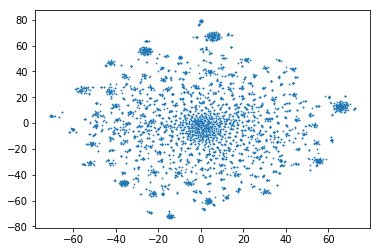

In [240]:
import matplotlib.pyplot as plt

fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

ax.scatter(x, y, s=0.5)
plt.show()

In [246]:
df = wp4_emb.i.to_frame()

In [248]:
df['x'] = x

In [249]:
df['y'] = y

In [254]:
df

,i,x,y
0,you,-29.269516,18.144510
1,the,29.741686,20.850861
2,me,24.850475,22.401928
3,to,-47.201187,28.110859
4,and,-14.469401,-27.885794
5,my,-33.185604,28.446508
6,a,-26.733624,-18.607996
7,it,-7.116469,26.284863
8,i'm,-31.006535,18.700996
9,in,-14.062546,35.313976


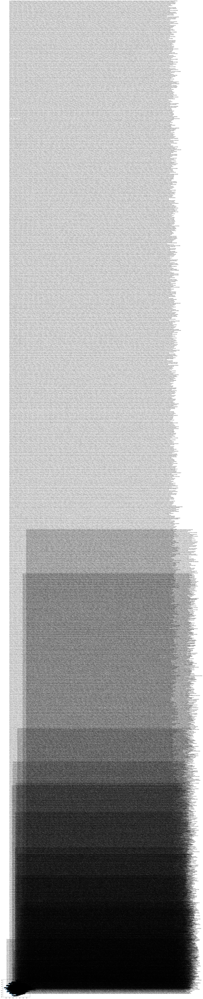

In [259]:
fig, ax = plt.subplots()
ax.scatter(df.x, df.y)

for i, txt in enumerate(df.i):
    ax.annotate(txt, (df.x[i], df.y[i]))

My attempt to visualize labels on top of the T-SNE graph failed. I would ideally make the cluster graph interactive, showing the label of each vector as the curser moves over it. 

But this modification is tangential to our aims in this workbook, so I leave it to future work.

# Concluding remarks

This workbook achieved its primary and secondary goals of successfully running StarSpace, understanding how to implement it on a custom modeling job, implementing said job, expanding the scope of the job's applications, and refining the model to increase predictive performance.

We generally found that a naive and untuned model could predict to an 80% accuracy (via small experimentation) the appropriate song ID from lyric snippets when the data being modeled contained 510 songs only. As soon as this dataset was expanded to include the entire 36k unique song IDs, this accuracy fell to 20%.

It seems that significant hyper-parameter tuning is needed to obtain similarly accurate performance over the entire song dataset. This effort is further complicated by the lack of a testing suite designed around this dataset with respect to song identification. Building such a suite would be a precursor to any in depth model tuning. I leave the creating a dedicated testing suite and in depth model tuning to future work.

Thus StarSpace showed potential as both a song and genre identifier, in a limited scope. Significant feature cleaning of genre, labelling of topics, and model tuning is required however to implement the embeddings and model in a viable consumer facing product. Overall however StarSpace has shown itself ot be an implementable and novel approach to music recommendation.